In [34]:
# Import Libraries

import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
matplotlib.use('TkAgg')  # Replace 'TkAgg' with a different backend if needed


# Set the plotting style
plt.style.use('ggplot')

# Set the default figure size
plt.rcParams['figure.figsize'] = (12, 8)

# Enable inline plotting
%matplotlib inline


In [35]:
# reading file data
df = pd.read_csv(r"C:\Users\gorja\Downloads\python\movies.csv")

In [9]:
# looking on the data
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [10]:
# checking any missing data (method 1)
missing_columns = df.columns[df.isnull().any()].tolist()
print("Missing columns:", missing_columns)

Missing columns: ['rating', 'released', 'score', 'votes', 'writer', 'star', 'country', 'budget', 'gross', 'company', 'runtime']


In [12]:
# checking missing data (method 2)
for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, pct_missing))

name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [13]:
# data types present in the columns
df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [17]:
#changing the datatypes for columns 
df['budget'] = pd.to_numeric(df['budget'], errors='coerce').astype('Int64')
df['gross'] = pd.to_numeric(df['gross'], errors='coerce').astype('Int64')
df['votes'] = pd.to_numeric(df['votes'], errors='coerce').astype('Int64')

In [18]:
df.head

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,<NA>,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,<NA>,<NA>,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,<NA>,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,<NA>,James Randall,James Randall,Christina Roz,United States,15000,<NA>,NaN,120.0


In [24]:
#creating correct year column
df['year_correct'] = df['released'].str.extract(r'(\d{4})')

In [62]:
df.head

<bound method NDFrame.head of       name  rating  genre  year  released     score         votes  director  \
0     6508       6      6  1980      1685  8.400000  9.270000e+05      2545   
1     5500       6      1  1980      1472  5.800000  6.500000e+04      2234   
2     5075       4      0  1980      1751  8.700000  1.200000e+06      1093   
3      282       4      4  1980      1472  7.700000  2.210000e+05      1279   
4     1016       6      4  1980      1523  7.300000  1.080000e+05      1037   
5     2088       6      9  1980      2474  6.400000  1.230000e+05      2487   
6     5501       6      0  1980      1751  7.900000  1.880000e+05      1390   
7     4376       6      3  1980       691  8.200000  3.300000e+05      1800   
8     5212       4      0  1980      1733  6.800000  1.010000e+05      2268   
9     6135       6      3  1980      2260  7.000000  1.000000e+04      2817   
10     457       4      0  1980       666  6.100000  1.800000e+04       352   
11    5843       4    

In [28]:
#sorting gross column in ascending values
df.sort_values(by=['gross'], inplace = False, ascending = False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162.0,2009
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181.0,2019
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194.0,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138.0,2015
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149.0,2018
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118.0,2019
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124.0,2015
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143.0,2012
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137.0,2015
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103.0,2019


In [27]:
#dispaying all data
pd.set_option('display.max_rows', None)

In [29]:
# drop any duplicates
df.drop_duplicates()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,1980
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95.0,1980
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133.0,1980
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.0,1980
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.0,1981
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100.0,1980


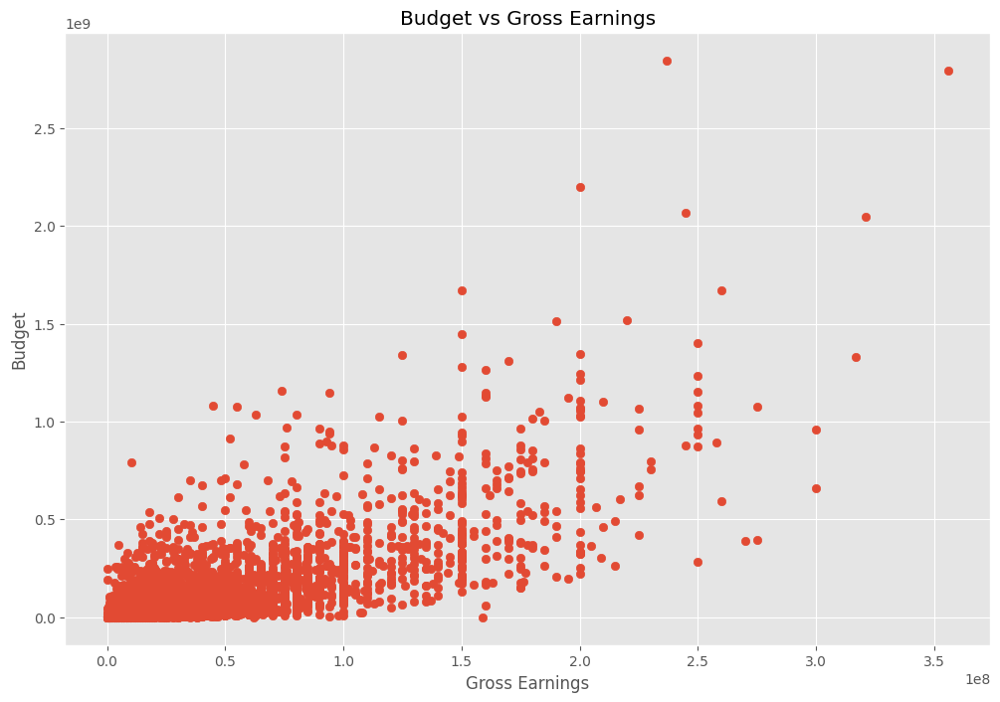

In [36]:
## Scatter plot with budget vs gross

plt.scatter(x=df['budget'], y=df['gross'])
plt.title('Budget vs Gross Earnings')
plt.xlabel('Gross Earnings')
plt.ylabel('Budget')
plt.show()

<Axes: xlabel='budget', ylabel='gross'>

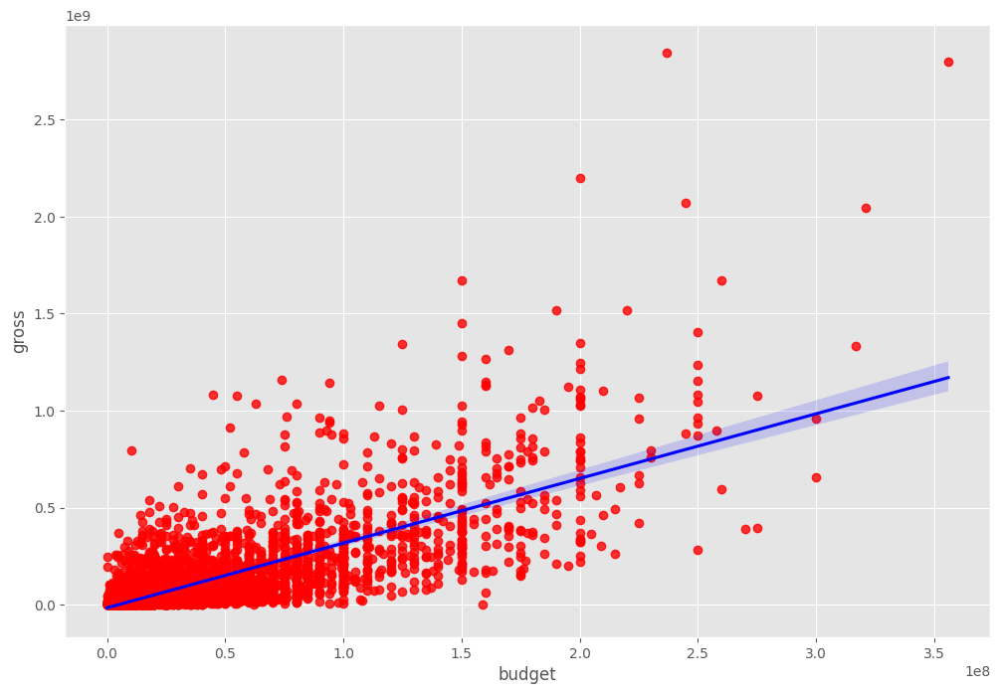

In [38]:
#ploting buget vs gross using seaborn

sns.regplot(x='budget', y='gross', data=df, scatter_kws={'color': 'red'}, line_kws={'color': 'blue'})


In [47]:
#lookimg at null values
df.isnull().sum()


name        0
rating      0
genre       0
year        0
released    0
score       0
votes       0
director    0
writer      0
star        0
country     0
budget      0
gross       0
company     0
runtime     0
dtype: int64

In [42]:
# Fill missing values with the mean of the column
numeric_columns = df.select_dtypes(include='number').columns
df[numeric_columns] = df[numeric_columns].fillna(df[numeric_columns].mean())



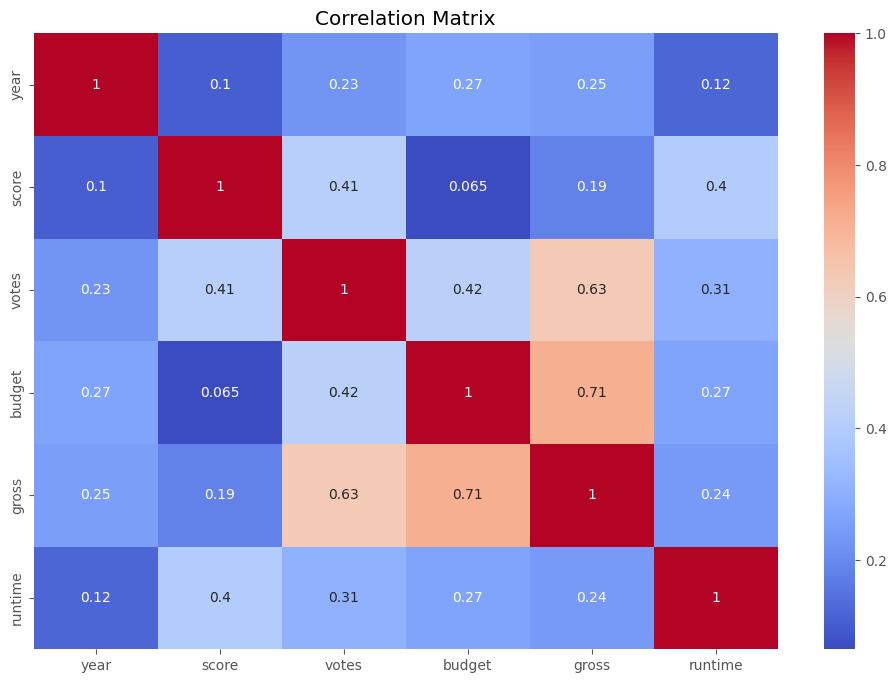

In [52]:
# calculating correlation on numeric columns
numeric_columns = df.select_dtypes(include='number').columns
correlation_matrix = df[numeric_columns].corr()

# Plot correlation matrix
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


In [55]:
#numerizing columns

df_numerized = df

for  col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name] = df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes
        
df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,6508,6,6,1980,1685,8.400000,9.270000e+05,2545,3960,1022,54,1.900000e+07,4.699877e+07,2274,146.000000
1,5500,6,1,1980,1472,5.800000,6.500000e+04,2234,1613,316,55,4.500000e+06,5.885311e+07,710,104.000000
2,5075,4,0,1980,1751,8.700000,1.200000e+06,1093,2535,1708,55,1.800000e+07,5.383751e+08,1506,124.000000
3,282,4,4,1980,1472,7.700000,2.210000e+05,1279,1976,2198,55,3.500000e+06,8.345354e+07,1770,88.000000
4,1016,6,4,1980,1523,7.300000,1.080000e+05,1037,511,398,55,6.000000e+06,3.984634e+07,1737,98.000000
5,2088,6,9,1980,2474,6.400000,1.230000e+05,2487,4306,234,55,5.500000e+05,3.975460e+07,1770,95.000000
6,5501,6,0,1980,1751,7.900000,1.880000e+05,1390,822,1250,55,2.700000e+07,1.152299e+08,2237,133.000000
7,4376,6,3,1980,691,8.200000,3.300000e+05,1800,1748,2192,55,1.800000e+07,2.340243e+07,612,129.000000
8,5212,4,0,1980,1733,6.800000,1.010000e+05,2268,1956,855,55,5.400000e+07,1.081857e+08,861,127.000000
9,6135,6,3,1980,2260,7.000000,1.000000e+04,2817,413,572,55,1.000000e+07,1.579519e+07,2228,100.000000


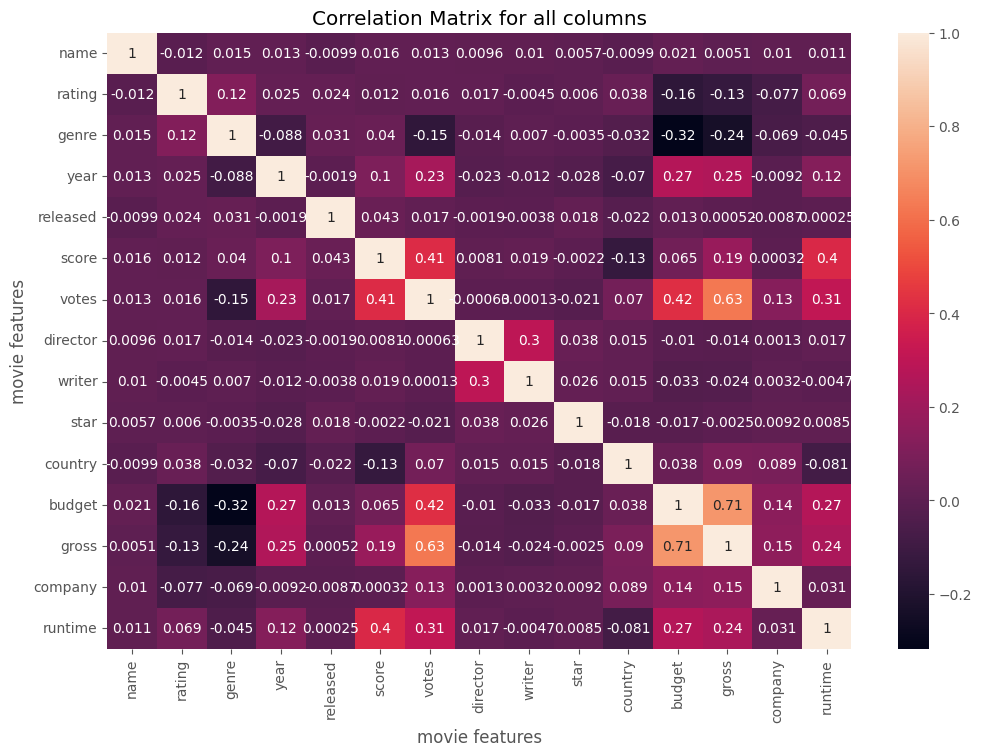

In [56]:
correlation_matrix = df_numerized.corr(method='pearson')
sns.heatmap(correlation_matrix, annot=True)
plt.title("Correlation Matrix for all columns")
plt.xlabel('movie features')
plt.ylabel('movie features')

plt.show()


In [58]:
df_numerized.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
name,1.000000,-0.011944,0.015250,0.013483,-0.009936,0.016160,0.013174,0.009605,0.010271,0.005666,-0.009942,0.020954,0.005071,0.010085,0.011130
rating,-0.011944,1.000000,0.117657,0.025120,0.024450,0.011562,0.016092,0.017211,-0.004538,0.005972,0.037765,-0.156385,-0.129384,-0.076860,0.069152
genre,0.015250,0.117657,1.000000,-0.088103,0.030843,0.040281,-0.148341,-0.013502,0.006956,-0.003450,-0.031503,-0.316818,-0.238240,-0.068755,-0.044531
year,0.013483,0.025120,-0.088103,1.000000,-0.001890,0.102154,0.226789,-0.022740,-0.012450,-0.027507,-0.070084,0.268848,0.254159,-0.009181,0.120810
released,-0.009936,0.024450,0.030843,-0.001890,1.000000,0.043226,0.016870,-0.001867,-0.003831,0.018129,-0.022073,0.013142,0.000520,-0.008693,0.000249
score,0.016160,0.011562,0.040281,0.102154,0.043226,1.000000,0.411938,0.008074,0.018887,-0.002196,-0.130144,0.064654,0.185084,0.000325,0.400526
votes,0.013174,0.016092,-0.148341,0.226789,0.016870,0.411938,1.000000,-0.000628,0.000133,-0.020975,0.069563,0.421218,0.629325,0.129579,0.309353
director,0.009605,0.017211,-0.013502,-0.022740,-0.001867,0.008074,-0.000628,1.000000,0.297418,0.037564,0.015242,-0.010373,-0.014106,0.001328,0.017403
writer,0.010271,-0.004538,0.006956,-0.012450,-0.003831,0.018887,0.000133,0.297418,1.000000,0.026462,0.014936,-0.033407,-0.023732,0.003174,-0.004657
star,0.005666,0.005972,-0.003450,-0.027507,0.018129,-0.002196,-0.020975,0.037564,0.026462,1.000000,-0.017577,-0.017244,-0.002506,0.009243,0.008550


In [59]:
# to have a quick view of correclation
correlation_mat = df_numerized.corr()
corr_pairs = correlation_mat.unstack()
corr_pairs

name      name        1.000000
          rating     -0.011944
          genre       0.015250
          year        0.013483
          released   -0.009936
          score       0.016160
          votes       0.013174
          director    0.009605
          writer      0.010271
          star        0.005666
          country    -0.009942
          budget      0.020954
          gross       0.005071
          company     0.010085
          runtime     0.011130
rating    name       -0.011944
          rating      1.000000
          genre       0.117657
          year        0.025120
          released    0.024450
          score       0.011562
          votes       0.016092
          director    0.017211
          writer     -0.004538
          star        0.005972
          country     0.037765
          budget     -0.156385
          gross      -0.129384
          company    -0.076860
          runtime     0.069152
genre     name        0.015250
          rating      0.117657
        

In [60]:
#in sorted pairs
sorted_pairs = corr_pairs.sort_values()
sorted_pairs

genre     budget     -0.316818
budget    genre      -0.316818
gross     genre      -0.238240
genre     gross      -0.238240
rating    budget     -0.156385
budget    rating     -0.156385
genre     votes      -0.148341
votes     genre      -0.148341
score     country    -0.130144
country   score      -0.130144
gross     rating     -0.129384
rating    gross      -0.129384
year      genre      -0.088103
genre     year       -0.088103
runtime   country    -0.081417
country   runtime    -0.081417
company   rating     -0.076860
rating    company    -0.076860
year      country    -0.070084
country   year       -0.070084
company   genre      -0.068755
genre     company    -0.068755
runtime   genre      -0.044531
genre     runtime    -0.044531
writer    budget     -0.033407
budget    writer     -0.033407
genre     country    -0.031503
country   genre      -0.031503
star      year       -0.027507
year      star       -0.027507
writer    gross      -0.023732
gross     writer     -0.023732
director

In [61]:
#viewing high correlated pairs

high_corr = sorted_pairs[(sorted_pairs) > 0.5]
high_corr

gross     votes       0.629325
votes     gross       0.629325
gross     budget      0.712561
budget    gross       0.712561
name      name        1.000000
director  director    1.000000
gross     gross       1.000000
budget    budget      1.000000
country   country     1.000000
star      star        1.000000
writer    writer      1.000000
votes     votes       1.000000
score     score       1.000000
released  released    1.000000
year      year        1.000000
genre     genre       1.000000
rating    rating      1.000000
company   company     1.000000
runtime   runtime     1.000000
dtype: float64

In [ ]:
# Therefore votes and budget have the highest correlation to gross 

#The companyhas low correlation